In [67]:
import pandas as pd 
import numpy as np 
import re
import plotly.express as px 
from scipy.optimize import curve_fit

import matplotlib.pyplot as plt
import seaborn as sns


In [2]:
from transformers import pipeline

classifier = pipeline(task="text-classification", 
                      model="SamLowe/roberta-base-go_emotions",
                      top_k=None, 
                      device='cuda'
                     )


In [3]:
text1 = pd.read_feather('data/text_df_1.feather')
text2 = pd.read_feather('data/text_df_2.feather')
text3 = pd.read_feather('data/text_df_3.feather')


In [4]:
text_df = pd.concat([
    text1, text2, text3
])

In [5]:
pattern = r'|<[^>]*>|https?://\S+|["\'\(\)_/+\\$-]'

text_df['semiclean_text'] = text_df['Text'].apply(lambda x: re.sub(pattern, '', x))
text_df['semiclean_text'] = text_df['semiclean_text'].apply(lambda x: re.sub(r'\s+', ' ', x))


In [6]:
text_df = text_df.reset_index(drop=True)

In [7]:
reviews = list(text_df['semiclean_text']) 

In [8]:
reviews_sample = [] 
idx = []
for i, x in enumerate(reviews):
    if i%10 == 0:
        reviews_sample.append(x)
        idx.append(i)

In [9]:
import torch
from torch.utils.data import Dataset, DataLoader
import tqdm

class TextDataset(Dataset):
    def __init__(self, sentences, tokenizer, max_length):
        self.sentences = sentences
        self.tokenizer = tokenizer
        self.max_length = max_length

    def __len__(self):
        return len(self.sentences)

    def __getitem__(self, idx):
        text = self.sentences[idx]

        ids = classifier.tokenizer(text)['input_ids'][:self.max_length-1] + [2] # adding end token
        tokens = classifier.tokenizer.convert_ids_to_tokens(ids)
        trimmed_text = classifier.tokenizer.convert_tokens_to_string(tokens)
        trimmed_text = re.sub('<s>|</s>', '', trimmed_text)
        
        return trimmed_text

# Create DataLoader
dataset = TextDataset(reviews_sample, classifier.tokenizer, max_length=512)

dataloader = DataLoader(dataset,
                        batch_size=1024,
                        shuffle=False,
                        num_workers=6, 
                        persistent_workers=True, 
                        pin_memory=True
                       )


In [10]:
dataset.__getitem__(109)

'I originally ordered two teas from Art of Tea the Silver Needles and the Coconut Creme. When my package came in, they had shipped the Coconut Creme and mistakenly bundled it with this Mandarin Silk tea by accident. I contacted Amazon and they refunded the Silver Needles and told me I could dispose of the Mandarin Silk Oolong as I saw fit. Well, since Im never one to turn down tea, I chose to dispose of it by, well, drinking it.This isnt a bad tea, first off. I dont have too much experience with oolongs, but I do like the flavor of this. However, I dont taste too much of the mandarin. It almost tastes sort of like a straight green tea, and it has a similar light greenyellow color. I drink it with a little honey.All in all, its a decent tea. I dont think Ill order it again, but Ill certainly finish off this tin.'

In [11]:
def classify(classifier, dataloader):
    outs = []
    for i, batch in tqdm.tqdm(enumerate(dataloader), total=len(dataloader)):
        outputs = classifier(batch)
    
        # the labels need to be sorted to concat them later
        for o in outputs: 
            o.sort(key = lambda x: x['label'])
        outs.append(outputs)

    flattened = []
    for batch in outs: 
        for record in batch: 
            flattened.append([x['score'] for x in record])

    scores = np.array(flattened)
    return scores

In [12]:
scores = classify(classifier, dataloader)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

# connecting it with data

In [18]:
import sqlite3

# Create a SQL connection to our SQLite database
con = sqlite3.connect("data/database.sqlite")

cur = con.cursor()

query_without_text = """
SELECT ProductId, UserId, ProfileName, HelpfulnessNumerator, HelpfulnessDenominator, Score, Time, Summary FROM Reviews
"""

df_without_text = pd.read_sql_query(query_without_text, con)

In [19]:
text_df.loc[idx][['ProductId', 'UserId']]

,ProductId,UserId
0,B001E4KFG0,A3SGXH7AUHU8GW
10,B0001PB9FE,A3HDKO7OW0QNK4
20,B001GVISJM,A1WO0KGLPR5PV6
30,B003F6UO7K,AFM0O9480F04W
40,B001EO5QW8,AQCY5KRO7489S
...,...,...
568410,B0018CLWM4,A88HLWDCU57WG
568420,B004BY23I8,A2B07RJZVDUJA5
568430,B001FPT1WM,A1XDMZMMOAMR7
568440,B005ZC0RRO,A2TO5R8QLIITEF


In [20]:
df_without_text = df_without_text.loc[idx].reset_index()

In [21]:
df = df_without_text.iloc[:len(scores)] # TO REMOVE LATER

In [28]:
labels = classifier(dataset.__getitem__(109))[0]
labels.sort(key = lambda x: x['label'])

In [31]:
labels = [x['label'] for x in labels]

In [33]:
scores_df = pd.DataFrame(scores, columns=labels) 

In [34]:
df = pd.concat([df, scores_df], axis=1) 

In [35]:
df

,index,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,admiration,...,love,nervousness,neutral,optimism,pride,realization,relief,remorse,sadness,surprise
0,0,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,0.819363,...,0.006001,0.000141,0.089491,0.007609,0.006000,0.011472,0.001724,0.000545,0.001192,0.000748
1,10,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,0.165347,...,0.096615,0.006082,0.009227,0.008943,0.017829,0.208147,0.031498,0.005812,0.004157,0.062480
2,20,B001GVISJM,A1WO0KGLPR5PV6,mom2emma,0,0,5,1313452800,Always fresh,0.025424,...,0.003132,0.000577,0.670136,0.003512,0.003882,0.022378,0.006141,0.000434,0.004764,0.000696
3,30,B003F6UO7K,AFM0O9480F04W,Sherril,0,0,5,1297641600,Great machine!,0.418269,...,0.138096,0.000135,0.099431,0.007586,0.002760,0.014744,0.001404,0.000378,0.000572,0.000928
4,40,B001EO5QW8,AQCY5KRO7489S,Garrett,0,0,5,1303430400,Why wouldn't you buy oatmeal from Mcanns? Tast...,0.808114,...,0.013625,0.001928,0.028021,0.010457,0.003746,0.024703,0.001944,0.001738,0.002547,0.005642
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56841,568410,B0018CLWM4,A88HLWDCU57WG,R28,2,2,5,1332979200,litter box,0.008595,...,0.002844,0.004866,0.241146,0.001896,0.001043,0.017348,0.001215,0.000565,0.008332,0.002142
56842,568420,B004BY23I8,A2B07RJZVDUJA5,P. Mase,0,0,4,1350518400,Co-co-yummy!,0.047761,...,0.698492,0.001224,0.036153,0.040542,0.001220,0.007117,0.000996,0.003533,0.004340,0.001003
56843,568430,B001FPT1WM,A1XDMZMMOAMR7,nyxport,0,0,5,1345161600,delicious,0.019470,...,0.002311,0.001235,0.308332,0.022238,0.005086,0.065890,0.009724,0.000623,0.001698,0.123634
56844,568440,B005ZC0RRO,A2TO5R8QLIITEF,SAK,1,1,5,1323734400,"Delicious, all natural and allergy free treats!",0.737945,...,0.307220,0.000321,0.021901,0.005181,0.003523,0.004006,0.001291,0.000313,0.001066,0.002945


In [36]:
df['Time'] = pd.to_datetime(df['Time'], unit='s')

In [37]:
df_grouped = df.groupby('Time')[labels].agg('mean').reset_index()

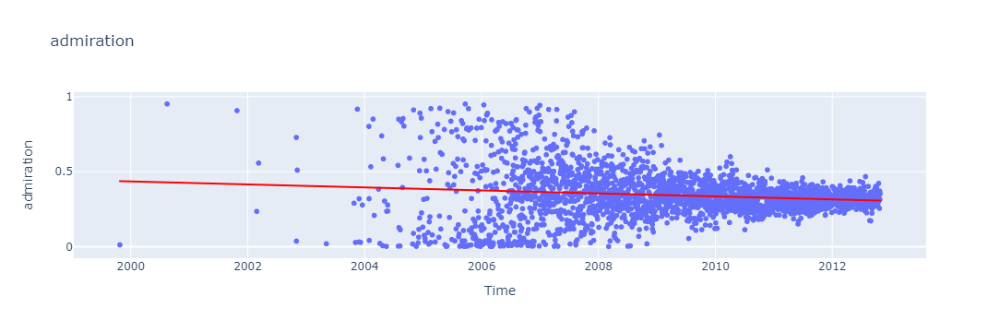

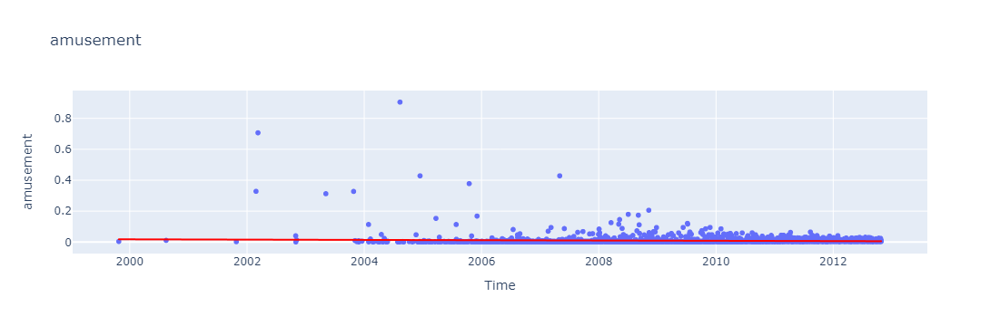

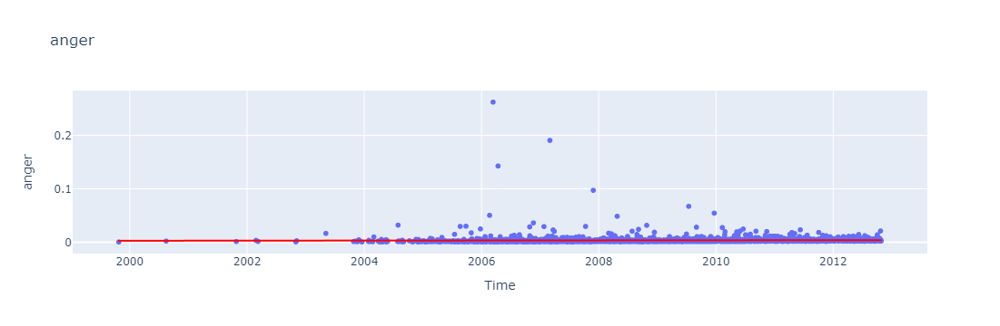

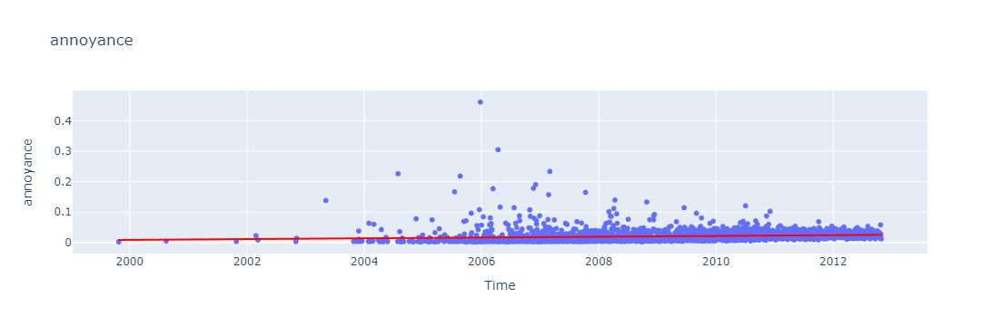

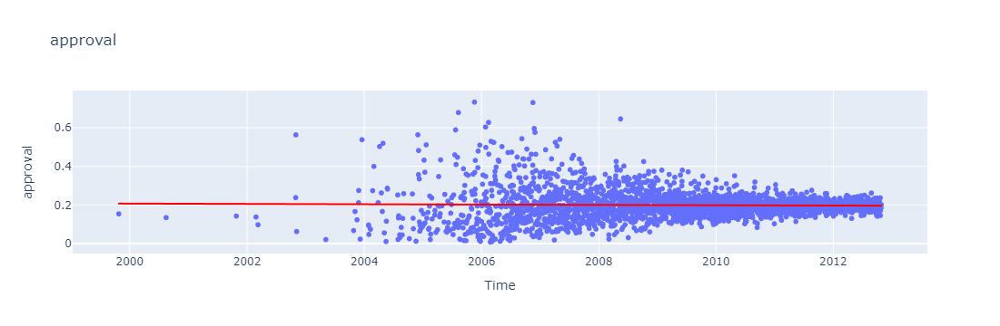

...

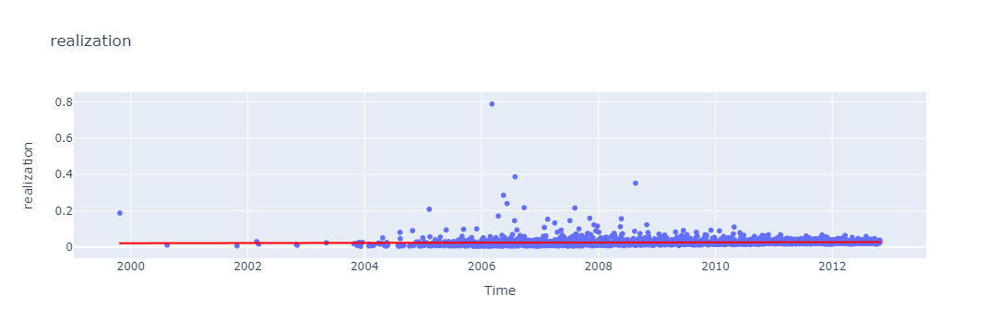

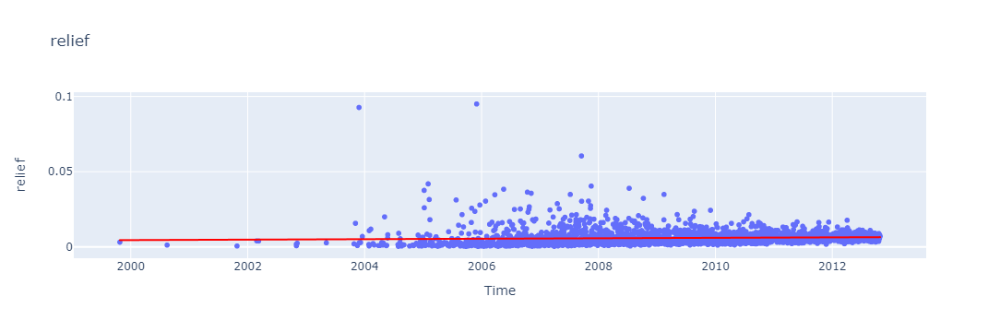

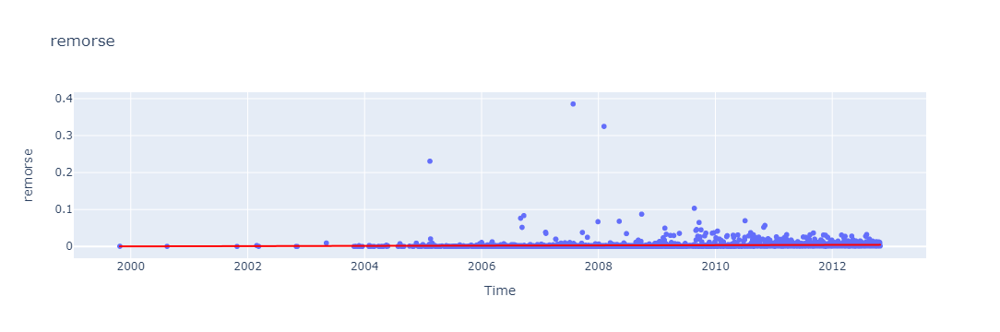

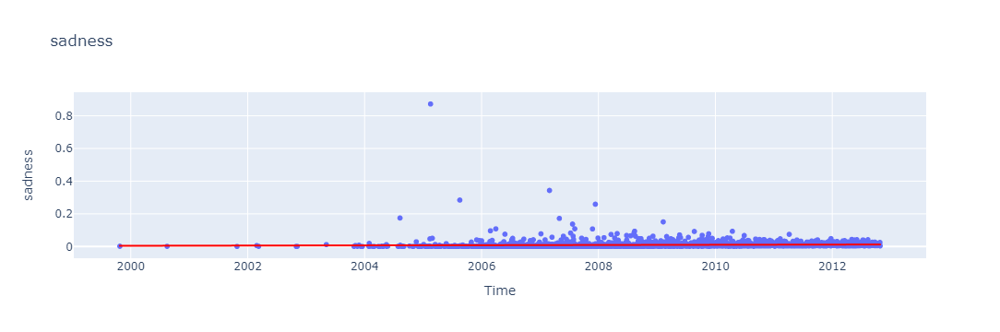

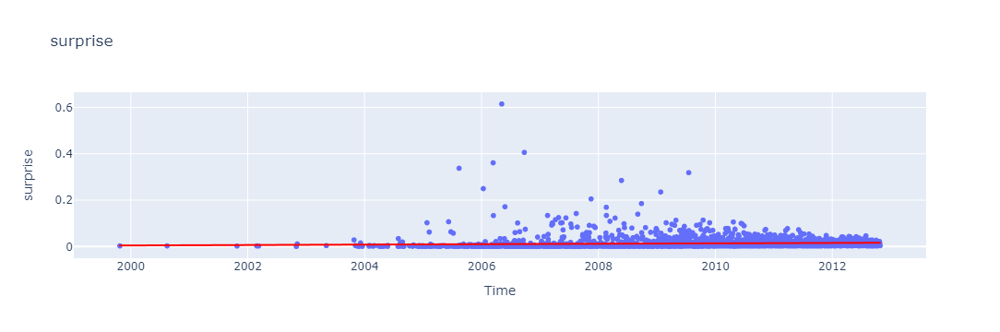

In [38]:
for label in labels:
    fig = px.scatter(df_grouped, x='Time', y=label, trendline='ols', trendline_color_override='red', title=label)
    fig.show()

# Timeseries - like vis 

In [39]:
data_size = df.copy()
data_size = data_size.set_index('Time')
data_size_monthly = data_size.groupby(pd.Grouper(freq="M"))['admiration'].mean()

In [45]:
data_size_monthly

Time
1999-10-31    0.011661
1999-11-30         NaN
1999-12-31         NaN
2000-01-31         NaN
2000-02-29         NaN
                ...   
2012-06-30    0.313966
2012-07-31    0.327451
2012-08-31    0.307505
2012-09-30    0.321643
2012-10-31    0.338357
Freq: M, Name: admiration, Length: 157, dtype: float64

In [46]:
data_size_monthly[48:146]

Time
2003-10-31    0.289454
2003-11-30    0.264280
2003-12-31    0.152663
2004-01-31    0.300739
2004-02-29    0.691770
                ...   
2011-07-31    0.293166
2011-08-31    0.300097
2011-09-30    0.320957
2011-10-31    0.314463
2011-11-30    0.318562
Freq: M, Name: admiration, Length: 98, dtype: float64

In [60]:
[data_size_monthly[57:146].isna()]

[Time
 2004-06-30     True
 2004-07-31    False
 2004-08-31    False
 2004-09-30    False
 2004-10-31    False
               ...  
 2011-07-31    False
 2011-08-31    False
 2011-09-30    False
 2011-10-31    False
 2011-11-30    False
 Freq: M, Name: admiration, Length: 90, dtype: bool]

In [68]:
x = np.arange(0, len(data_size_monthly[57:146]), 1)
coef = curve_fit(lambda t,a,b: a + np.exp(b*t), x,  data_size_monthly[57:146])[0]

x_short = np.arange(0, len(data_size_monthly[57:146]), 1)



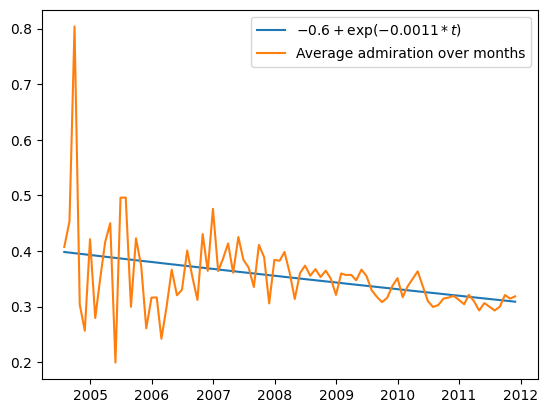

In [71]:
coef_short = curve_fit(lambda t,a,b: a + np.exp(b*t), x_short,  data_size_monthly[57:146])[0]
plt.plot(data_size_monthly[57:146].index.to_series(), coef[0] + np.exp(coef[1]*x))
# plt.plot(data_size_monthly.index.to_series()[48:146], coef_short[0] + np.exp(coef_short[1]*x_short))
plt.plot(data_size_monthly[57:146].index.to_series(), data_size_monthly[57:146])
plt.legend([f'${round(coef[0], 2)} + \exp({round(coef[1], 4)} * t)$', 'Average admiration over months'])
plt.show()

# Let's try PCA 

In [156]:
import numpy as np
from sklearn.decomposition import PCA



In [157]:
scores

array([[8.19363177e-01, 5.41676942e-04, 1.08817907e-03, ...,
        5.45072136e-04, 1.19183958e-03, 7.48314545e-04],
       [1.65346518e-01, 7.19280355e-03, 3.65029206e-03, ...,
        5.81245124e-03, 4.15727450e-03, 6.24800995e-02],
       [2.54240129e-02, 7.08238047e-04, 1.07695872e-03, ...,
        4.33685462e-04, 4.76371497e-03, 6.96458912e-04],
       ...,
       [1.94696169e-02, 1.96551252e-03, 5.45673305e-04, ...,
        6.22841413e-04, 1.69822574e-03, 1.23634398e-01],
       [7.37944901e-01, 1.32105069e-03, 1.29605201e-03, ...,
        3.13399185e-04, 1.06575585e-03, 2.94476375e-03],
       [1.06640914e-02, 8.65448441e-04, 5.62562980e-03, ...,
        1.29926996e-02, 4.04243283e-02, 6.59207255e-03]])

In [158]:
X = scores

In [159]:
pca = PCA(n_components=2)

In [160]:
X_pca = pca.fit_transform(X)
pca.explained_variance_

array([0.12027561, 0.08364971])

In [161]:
wanted_labels = ['admiration', 'approval', 'love', 'disapproval', 'disappointment', 'annoyance']

In [162]:
X = np.array(df[wanted_labels])

In [163]:
X_pca = pca.fit_transform(X)

In [164]:
pca.explained_variance_

array([0.10784425, 0.07906715])

PCA did only explain 20% of the variance. In my opinion it is not enough to create valid analysis. 

# What products were the best? 


In [166]:
products = df.groupby(['ProductId']).admiration.agg(['mean','count']).reset_index()

In [167]:
products[products['count'] > 5]

,ProductId,mean,count
2,7310172001,0.344468,17
3,7310172101,0.324111,17
5,B00004CI84,0.575578,19
6,B00004CXX9,0.355632,20
10,B00004RAMY,0.243791,17
...,...,...,...
26218,B009B87SAC,0.027760,8
26226,B009E7YC54,0.384895,24
26229,B009GHI5Q4,0.020909,8
26250,B009M2LUEW,0.346219,7


In [168]:
products[products['count'] > 25]

,ProductId,mean,count
752,B0001ES9F8,0.349317,29
1829,B0007A0AQM,0.309081,42
1830,B0007A0AQW,0.213539,42
2214,B0009YJ4CW,0.139562,26
2447,B000BRR8VQ,0.298472,43
...,...,...,...
26030,B008JKU2CO,0.381014,39
26111,B008RWUHA6,0.337904,30
26112,B008RWUKXK,0.399538,30
26148,B008ZRKZSM,0.433877,31


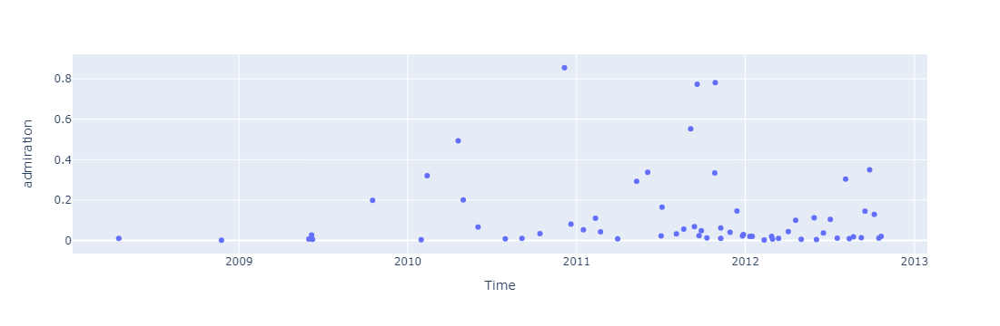

In [169]:
px.scatter(df[df.ProductId == 'B002QWP89S'], x = 'Time', y='admiration')

This could be very good approach to see the changing emotions related to the product. In a way, explaining the product decline. Lets take a product that in 2010 was quite good and in 2012 not so much

# Another model

In [170]:
from transformers import pipeline

distilled_student_sentiment_classifier = pipeline(
    model="lxyuan/distilbert-base-multilingual-cased-sentiments-student", 
    top_k=None,
    device='cuda',
    batch_size=6, 
    truncation=True
    
)


In [171]:
import torch
from torch.utils.data import Dataset, DataLoader
import tqdm

class TextDataset(Dataset):
    def __init__(self, sentences, tokenizer, max_length):
        self.sentences = sentences
        self.tokenizer = tokenizer
        self.max_length = max_length

    def __len__(self):
        return len(self.sentences)

    def __getitem__(self, idx):
        text = self.sentences[idx]

        ids = distilled_student_sentiment_classifier.tokenizer(text)['input_ids'][:self.max_length-1] + [102] # adding end token
        tokens = distilled_student_sentiment_classifier.tokenizer.convert_ids_to_tokens(ids)
        trimmed_text = distilled_student_sentiment_classifier.tokenizer.convert_tokens_to_string(tokens)
        trimmed_text = re.sub('<s>|</s>', '', trimmed_text)
        
        return trimmed_text

# Create DataLoader
dataset = TextDataset(reviews_sample, distilled_student_sentiment_classifier.tokenizer, max_length=510)

dataloader = DataLoader(dataset,
                        batch_size=256,
                        shuffle=False,
                        num_workers=6, 
                        #persistent_workers=True, 
                        pin_memory=True
                       )


In [172]:
dataset.__getitem__(0)

'[CLS] I have bought several of the Vitality canned dog food products and have found them all to be of good quality. The product looks more like a stew than a processed meat and it smells better. My Labrador is finicky and she appreciates this product better than most. [SEP] [SEP]'

In [173]:
scores = classify(classifier=distilled_student_sentiment_classifier, dataloader=dataloader)

  0%|                                                                                                                          | 0/223 [00:00<?, ?it/s]Token indices sequence length is longer than the specified maximum sequence length for this model (628 > 512). Running this sequence through the model will result in indexing errors
Token indices sequence length is longer than the specified maximum sequence length for this model (708 > 512). Running this sequence through the model will result in indexing errors
Token indices sequence length is longer than the specified maximum sequence length for this model (1293 > 512). Running this sequence through the model will result in indexing errors
Token indices sequence length is longer than the specified maximum sequence length for this model (577 > 512). Running this sequence through the model will result in indexing errors
Token indices sequence length is longer than the specified maximum sequence length for this model (687 > 512). Running t

In [174]:
scores2 = scores

In [175]:
scores

array([[0.08628431, 0.1144843 , 0.79923141],
       [0.35531473, 0.11743043, 0.52725488],
       [0.43399811, 0.17478064, 0.39122128],
       ...,
       [0.40636668, 0.16198073, 0.43165255],
       [0.0677125 , 0.1453674 , 0.78692007],
       [0.59419638, 0.20670271, 0.19910094]])

In [176]:
labels = ['negative', 'neutral', 'positive']

In [177]:
scores_df2 = pd.DataFrame(scores2, columns=labels) 

In [178]:
df2 = df_without_text.iloc[:len(scores2)]
df2 = pd.concat([df2, scores_df2], axis=1) 

In [179]:
reviews_sample[3]

'I have never been a huge coffee fan. However, my mother purchased this little machine and talked me into trying the Latte Macciato. No Coffee Shop has a better one and I like most of the other products, too as a usually noncoffee drinker!.The little Dolche Guesto Machine is super easy to use and prepares a really good CoffeeLatteCappuccinoetc in less than a minute if water is heated up. I would recommend the Dolce Gusto to anyone. Too good for the price and Iam getting one myself! :'

In [180]:
df2

,index,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,negative,neutral,positive
0,0,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,0.086284,0.114484,0.799231
1,10,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,0.355315,0.117430,0.527255
2,20,B001GVISJM,A1WO0KGLPR5PV6,mom2emma,0,0,5,1313452800,Always fresh,0.433998,0.174781,0.391221
3,30,B003F6UO7K,AFM0O9480F04W,Sherril,0,0,5,1297641600,Great machine!,0.086998,0.221173,0.691829
4,40,B001EO5QW8,AQCY5KRO7489S,Garrett,0,0,5,1303430400,Why wouldn't you buy oatmeal from Mcanns? Tast...,0.020845,0.049047,0.930109
...,...,...,...,...,...,...,...,...,...,...,...,...
56841,568410,B0018CLWM4,A88HLWDCU57WG,R28,2,2,5,1332979200,litter box,0.733588,0.133166,0.133247
56842,568420,B004BY23I8,A2B07RJZVDUJA5,P. Mase,0,0,4,1350518400,Co-co-yummy!,0.248754,0.121860,0.629386
56843,568430,B001FPT1WM,A1XDMZMMOAMR7,nyxport,0,0,5,1345161600,delicious,0.406367,0.161981,0.431653
56844,568440,B005ZC0RRO,A2TO5R8QLIITEF,SAK,1,1,5,1323734400,"Delicious, all natural and allergy free treats!",0.067713,0.145367,0.786920


In [181]:
df_grouped = df2.groupby('Time')[labels].agg('mean').reset_index()

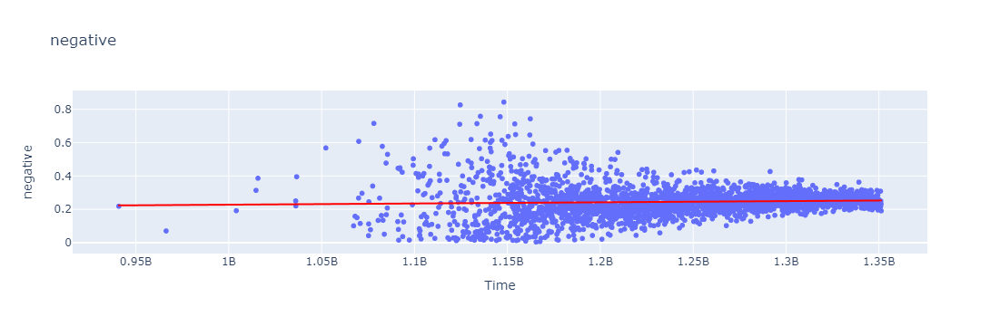

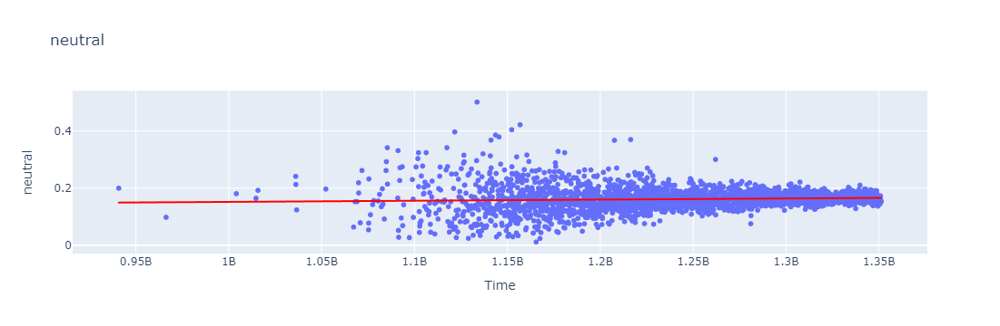

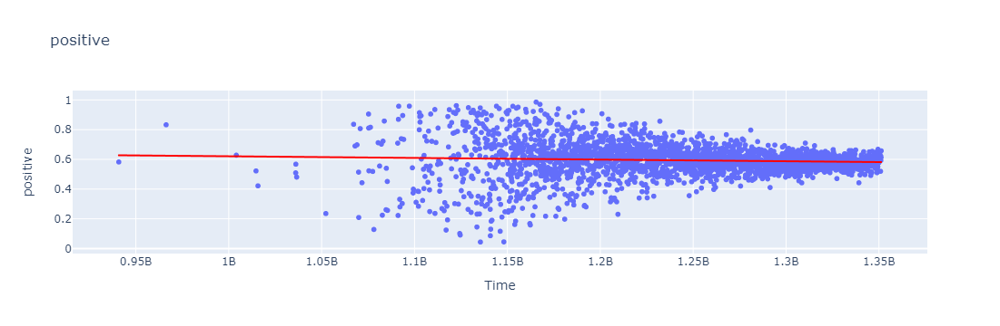

In [182]:
for label in labels:
    fig = px.scatter(df_grouped, x='Time', y=label, trendline='ols', trendline_color_override='red', title=label)
    fig.show()

# Adding the analysis by the user id and product id 


In [183]:
users = df2.groupby(['UserId', 'ProfileName']).negative.agg(['mean', 'count'])

In [184]:
users[users['count']>10].sort_values('mean', ascending=False)

,,mean,count
UserId,ProfileName,,
A3TVZM3ZIXG8YW,christopher hayes,0.605528,21
A2M9D9BDHONV3Y,A. Bennett,0.475068,13
AKZKG2Z7CNV27,BreezyPaige,0.445854,12
A3QNQQKJTL76H0,buru buru piggu,0.438283,12
A2XNJJ9TF70P4J,Angie,0.430487,12
...,...,...,...
A3OXHLG6DIBRW8,"C. F. Hill ""CFH""",0.112618,47
A3EBHHCZO6V2A4,"Amaranth ""music fan""",0.111387,13
A3PD8JD9L4WEII,"Bron ""Bron""",0.110343,11


In [186]:
df2[df2.UserId == 'A3TVZM3ZIXG8YW'].index

Index([ 5251,  5256,  9798,  9803, 22425, 22426, 24706, 24711, 31886, 36978,
       36979, 42924, 42925, 43264, 43265, 44295, 44516, 44521, 51414, 51469,
       53233],
      dtype='int64')

In [187]:
np.array(reviews_sample)[list(df2[df2.UserId == 'A3TVZM3ZIXG8YW'].index)][0]

'This review will make me sound really stupid, but whatever. I dont really care as long as people find out whats real and can avoid my mistakes.I got my wonderful little sweet Bella Bean when she was a few days shy of three years old. She had been bounced around from house to house and eating whatever was cheap. I have had cats around me my entire life, for about twentyfive years now. My mother always just fed them whatever, the kinds of food you buy in the supermarket Friskies, Nine Lives, Kit & Kaboodle, stuff like that. And our cats were always fine, at least in terms of their eating habits. They would eat in the morning, stop when they were done, come back, and eat some more when they got hungry.My housemate at the time was working for Hills and assured me that this was the best food ever made, so great, so on and so forth. I now know that she is an utter buffoon, but I initially trusted her judgment, which is so unfortunate because she doesnt think. She also had plenty of coupons 

In [189]:
np.array(reviews_sample)[list(df2[df2.UserId == 'A2M9D9BDHONV3Y'].index)][0]


'I decided to try multiple Hormel products when the sale made their price reasonable but I found many of the products to be just HORRIBLE! This particular Chicken and Noodle is a bowl of salt with hard, thick noodles and a few little pieces of chicken. They do give lots of sauce though! I love sauce but ended up spitting out the noodles because they were just awful. And though I love salt....this product was mostly salt. I ended up giving all but the one I tried to eat to the local food bank. I do feel guilty about that but I am sure someone might like this product. I will never buy this product again and I do not recommend it to anyone. Buy it at your own risk!!'

In [190]:
np.array(reviews_sample)[list(df2[df2.UserId == 'A2M9D9BDHONV3Y'].index)][1]

'If youve ever peeled and cut whole mangos youll appreciate this can of delicious prepared mangos. There has to be 2 or 3 whole mangos per can. If they would use the natural mango juice instead of light sugary syrup they would have a HIT on their hands. Still, even with the high sugar content, these canned mangos are terrific as a cake or ice cream topping or even just by themselves. I will be buying this product again when its in stock and on sale again. If you like mangos and can tolerate some added sugar, I highly recommend this canned fruit. Roland does a nice job with their fruits but stay away from their vegetables.'

In [188]:
df2[df2.UserId == 'A2M9D9BDHONV3Y']

,index,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,negative,neutral,positive
7077,70770,B001E50UBE,A2M9D9BDHONV3Y,A. Bennett,3,3,1,1242000000,I did not like these at all!!!,0.457167,0.216585,0.326248
7552,75520,B000UXTA9O,A2M9D9BDHONV3Y,A. Bennett,5,5,5,1240617600,This is delicious though a bit too sweet with ...,0.254047,0.162034,0.583919
8657,86570,B0017129VO,A2M9D9BDHONV3Y,A. Bennett,5,6,3,1272153600,This was very tasty but way to fatty!,0.743945,0.122188,0.133867
15726,157260,B001E55YXS,A2M9D9BDHONV3Y,A. Bennett,4,9,1,1242777600,Awful!!!,0.687377,0.174960,0.137663
19437,194370,B001BM6SKC,A2M9D9BDHONV3Y,A. Bennett,2,2,5,1237248000,Scrumptious!!!,0.426732,0.065127,0.508141
23640,236400,B001710LIW,A2M9D9BDHONV3Y,A. Bennett,5,6,3,1272153600,This was very tasty but way to fatty!,0.743945,0.122188,0.133867
24726,247260,B000EOXQS0,A2M9D9BDHONV3Y,A. Bennett,12,28,1,1248220800,As much as I LOVE this soup mix....it'll kill ...,0.574807,0.178010,0.247184
25628,256280,B0009Z0WSQ,A2M9D9BDHONV3Y,A. Bennett,19,32,1,1271203200,Why don't manufacturers listen to their custom...,0.424746,0.112117,0.463137
31279,312790,B0081XSVNQ,A2M9D9BDHONV3Y,A. Bennett,0,5,1,1343174400,Read all the ingredients......awful!,0.674317,0.125385,0.200298
37344,373440,B001BM62T4,A2M9D9BDHONV3Y,A. Bennett,0,0,4,1243814400,A Unique flavor!,0.307232,0.243307,0.449461


In [75]:
df2[df2.UserId == 'A7EK88GF8N40F']

,index,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,negative,neutral,positive
5434,54340,B001EO5YCA,A7EK88GF8N40F,Nicole S. Urdang,2,2,5,1221436800,Wrong nutritional info but great taste,0.286499,0.222955,0.490546
10538,105380,B001EQ4QJK,A7EK88GF8N40F,Nicole S. Urdang,2,2,5,1328745600,Incredible,0.085972,0.064897,0.849131
13498,134980,B004HOQE64,A7EK88GF8N40F,Nicole S. Urdang,2,2,5,1328745600,Incredible,0.528313,0.206722,0.264965
13926,139260,B004T80BYE,A7EK88GF8N40F,Nicole S. Urdang,3,4,3,1319846400,Unusual product,0.425537,0.112554,0.461909
15412,154120,B000F4EU3E,A7EK88GF8N40F,Nicole S. Urdang,6,6,2,1162252800,Disappointment in a can...times six,0.083342,0.107557,0.809101
24634,246340,B005QSIFUS,A7EK88GF8N40F,Nicole S. Urdang,0,0,5,1331251200,"Excellent sugar free chocolate, and a recipe f...",0.407254,0.251215,0.341531
26826,268260,B0040K41MY,A7EK88GF8N40F,Nicole S. Urdang,0,1,3,1338681600,Good when coated in 70% chocolate,0.398731,0.287568,0.313701
29564,295640,B001E5E1WS,A7EK88GF8N40F,Nicole S. Urdang,0,0,5,1224720000,Superb!,0.423756,0.317878,0.258366
30713,307130,B004HOOZEW,A7EK88GF8N40F,Nicole S. Urdang,2,2,5,1328745600,Incredible,0.423371,0.222939,0.353690
34785,347850,B000ZT15EQ,A7EK88GF8N40F,Nicole S. Urdang,1,1,5,1328745600,A great little snack,0.166150,0.201197,0.632653


In [79]:
df2.groupby('Score').negative.agg('mean')

Score
1    0.255877
2    0.252177
3    0.250143
4    0.247658
5    0.250700
Name: negative, dtype: float64